In [1]:
import pydicom 
import matplotlib.pyplot as plt
import cv2
from PIL import Image
import numpy as np

In [2]:
dataset = pydicom.dcmread('/mnt/storage/breast_cancer_kaggle/train_images/4813/1025021952.dcm')

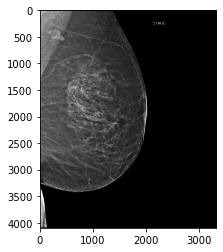

In [3]:
plt.imshow(dataset.pixel_array, cmap=plt.cm.gray)
plt.show()

In [4]:
dataset.pixel_array.dtype

dtype('uint16')

In [5]:
new_im = dataset.pixel_array.astype(dtype='uint8')

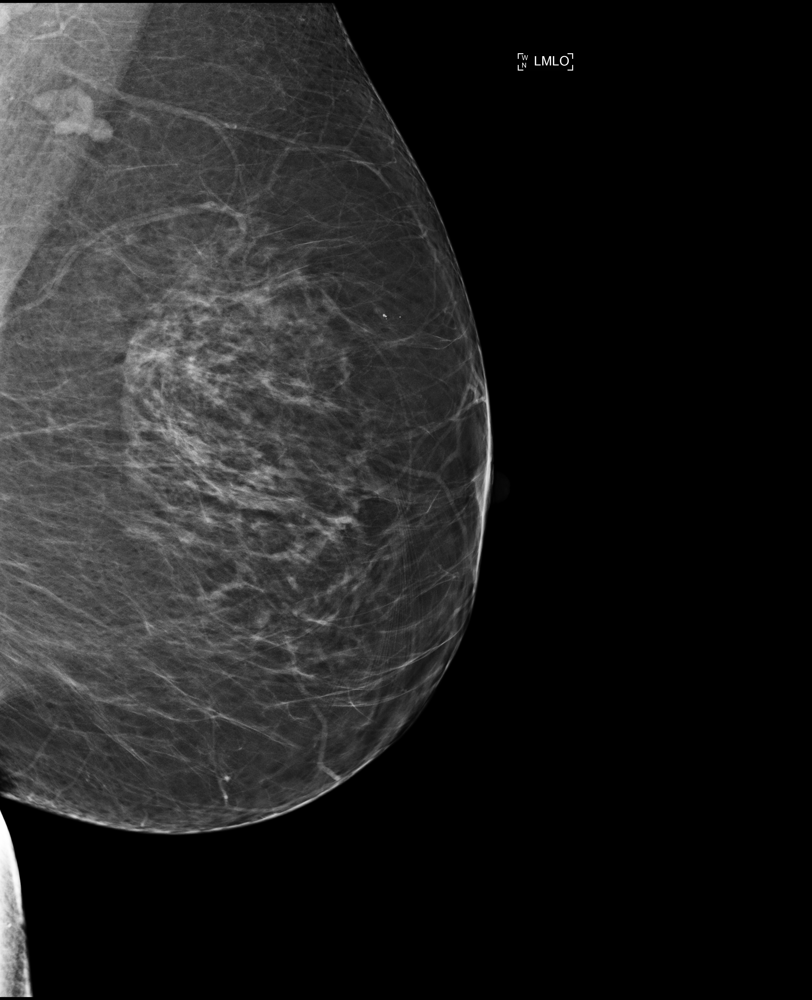

In [6]:
image_new = Image.fromarray(new_im)
image_new

In [7]:
img = cv2.imread('1025021952.png', 0)
print(img.shape)

(4096, 3328)


In [9]:
cv2.imwrite('1025021952.png', image_new)

error: OpenCV(4.8.0) :-1: error: (-5:Bad argument) in function 'imwrite'
> Overload resolution failed:
>  - img is not a numpy array, neither a scalar
>  - Expected Ptr<cv::UMat> for argument 'img'


# add gaussian noise

In [10]:
gauss_noise=np.zeros(img.shape,dtype=np.uint8)
cv2.randn(gauss_noise,128,20)
gauss_noise=(gauss_noise*0.5).astype(np.uint8)
gn_img=cv2.add(img,gauss_noise)

In [11]:
cv2.imwrite('1025021952.png', gn_img)

True

In [25]:
newsize = (256, 256)
img_org = Image.open('1025021952.png')
image_new = img_org.resize(newsize)
image_new.size

(256, 256)

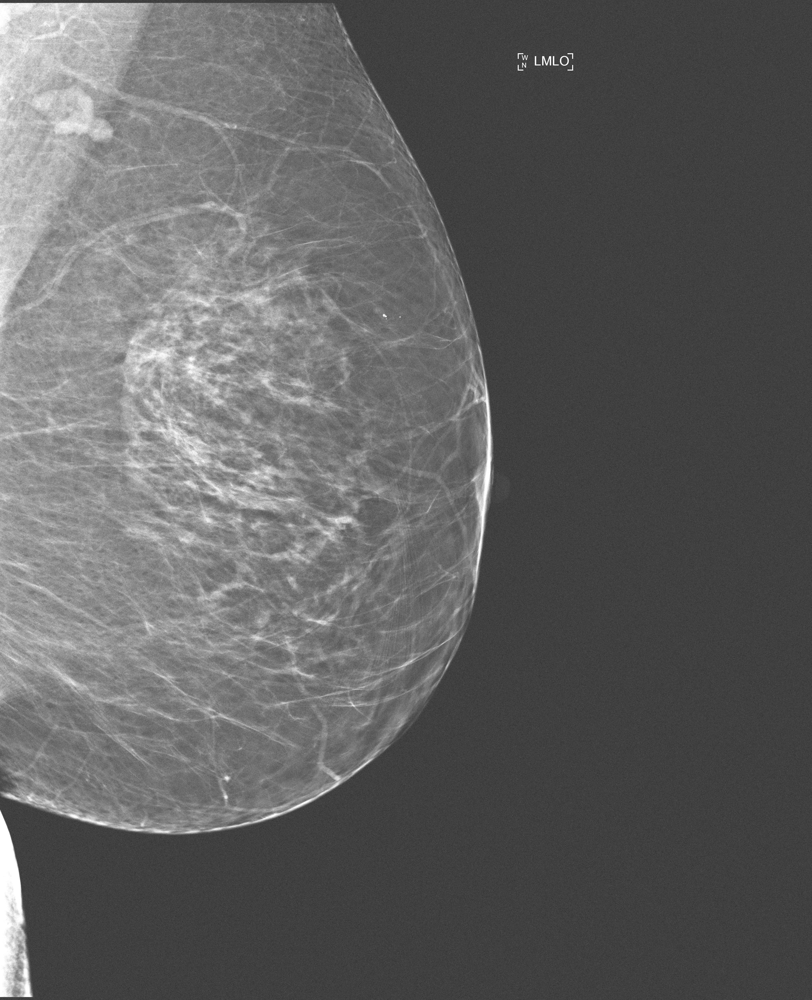

In [29]:
gn_img_new = Image.fromarray(gn_img)
gn_img_new

Text(0.5, 1.0, 'Combined')

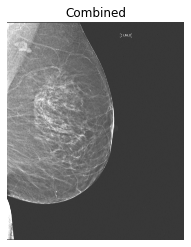

In [28]:
plt.imshow(gn_img,cmap='gray')
plt.axis("off")
plt.title("Combined")

In [8]:
from wand.image import Image
with Image(filename = '1025021952.png') as img:
    img.distort('arc', (60, ))
    img.save(filename = 'distort1.png')

In [14]:
from skimage import image_as_ubyte
from skimage.io import imread, imsave
from block_distortion import distort_image


ImportError: cannot import name 'image_as_ubyte' from 'skimage' (/home/zzhang/anaconda3/lib/python3.9/site-packages/skimage/__init__.py)

In [2]:
import os, glob
path = '/mnt/storage/breast_cancer_kaggle/train_images/'
save_path = '/mnt/storage/breast_cancer_kaggle/images_data/train_png/'
#save_path_p = []
train_p = os.walk(path)
for (root, dirnames, filenames) in train_p:
    patient_id = root[47:]
    # for dir_name in dirnames:
    #   print(len(dirnames))
    #   print("directory name ", dir_name)
    #   print(os.path.join(root, dir_name))
    #   save_path_p = os.path.join(save_path, dir_name)
    #   os.mkdir(save_path_p)

    for f_name in filenames:
      print("patient_id", patient_id)
      print(len(filenames))
      print("filenames ", f_name[:-4])
      print(os.path.join(root, f_name))

      f_name_tranc = f_name[:-4]

      dataset = pydicom.dcmread(os.path.join(root, f_name))
      new_im = dataset.pixel_array.astype(dtype='uint8')
      image_new = im.fromarray(new_im)

      save_path_p_i = os.path.join(save_path, patient_id, f_name_tranc)
      print(save_path_p_i)
      image_new.save(save_path_p_i+'.png')
      
    #print(root)
    
    

    #print(len(dirpath))
    # for i in range(len(dirnames)):
    #     
    
    # for j in range(len(filenames)):
    #     #os.mkdir(os.path.join(save_path, dirnames))
    #     cur_f_path = os.path.join(dirpath, filenames[j])
    #     print(cur_f_path)
        
    #     # dataset = pydicom.dcmread(os.path.join(dirpath, filenames[i]))
    #     # new_im = dataset.pixel_array.astype(dtype='uint8')
    #     # image_new = im.fromarray(new_im)
    #     filename_tranc = filenames[j][:-4]
    #     print(filename_tranc)
    #     print("save path")
    #     save_path_pid = os.path.join(save_path, patient_id, filename_tranc)
    #     print(save_path_pid)
    #     image_new.save(save_path_pid+'.png')
        

patient_id 46381
5
filenames  869740960
/mnt/storage/breast_cancer_kaggle/train_images/46381/869740960.dcm
/mnt/storage/breast_cancer_kaggle/images_data/train_png/46381/869740960
patient_id 46381
5
filenames  1369765233
/mnt/storage/breast_cancer_kaggle/train_images/46381/1369765233.dcm
/mnt/storage/breast_cancer_kaggle/images_data/train_png/46381/1369765233
patient_id 46381
5
filenames  1745371300
/mnt/storage/breast_cancer_kaggle/train_images/46381/1745371300.dcm
/mnt/storage/breast_cancer_kaggle/images_data/train_png/46381/1745371300
patient_id 46381
5
filenames  1569721693
/mnt/storage/breast_cancer_kaggle/train_images/46381/1569721693.dcm
/mnt/storage/breast_cancer_kaggle/images_data/train_png/46381/1569721693
patient_id 46381
5
filenames  863830572
/mnt/storage/breast_cancer_kaggle/train_images/46381/863830572.dcm
/mnt/storage/breast_cancer_kaggle/images_data/train_png/46381/863830572
patient_id 40317
7
filenames  877739785
/mnt/storage/breast_cancer_kaggle/train_images/40317/877

KeyboardInterrupt: 

In [27]:
path = '/mnt/storage/breast_cancer_kaggle/train_images/'
save_path = '/mnt/storage/breast_cancer_kaggle/images_data/train_png/'
train_p = os.walk(path)
train_png = os.walk(save_path)
for (dirpath, dirnames, filenames) in train_p:
    print(len(dirnames))
for (dirpath_s, dirnames_s, filenames_s) in train_png:
    print(len(dirnames_s))

11913
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0


KeyboardInterrupt: 

(3328, 4096)


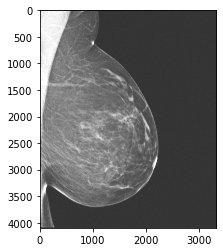

In [31]:
#path = '/mnt/storage/breast_cancer_kaggle/images_data/data_png/total_png/'

import os
from PIL import Image
from matplotlib import pyplot as plt

img_path = '/mnt/storage/breast_cancer_kaggle/images_data/data_png/try_f/2460/612483566.png'
img = Image.open(img_path)
print(img.size)
plt.imshow(img, cmap='gray')
plt.show()